In [1]:
import json
import cv2
from pathlib import Path
from decord import VideoReader
from decord import cpu, gpu
from matplotlib import pyplot as plt
import numpy as np
from collections import defaultdict
import uuid

In [2]:
with open(r"E:\Python_Projects\HSE_diploma\data\test_from_person\uid_vid_00000.mp4.json", "r", encoding="utf-8") as f:
    son = json.load(f)

In [3]:
son

{'entities': [{'bb': [413, 395, 37, 201],
   'blob': {'frame_idx': 24},
   'confidence': 1.0,
   'id': 0,
   'labels': {'reflection': 1},
   'time': 1000},
  {'bb': [417, 401, 50, 193],
   'blob': {'frame_idx': 29},
   'confidence': 1.0,
   'id': 0,
   'labels': {'reflection': 1},
   'time': 1209},
  {'bb': [426, 357, 50, 224],
   'blob': {'frame_idx': 34},
   'confidence': 1.0,
   'id': 0,
   'labels': {'reflection': 1},
   'time': 1418},
  {'bb': [430, 344, 69, 239],
   'blob': {'frame_idx': 38},
   'confidence': 1.0,
   'id': 0,
   'labels': {'reflection': 1},
   'time': 1584},
  {'bb': [446, 341, 69, 243],
   'blob': {'frame_idx': 43},
   'confidence': 1.0,
   'id': 0,
   'labels': {'reflection': 1},
   'time': 1793},
  {'bb': [464, 372, 59, 196],
   'blob': {'frame_idx': 48},
   'confidence': 1.0,
   'id': 0,
   'labels': {'reflection': 1},
   'time': 2001},
  {'bb': [478, 318, 59, 239],
   'blob': {'frame_idx': 53},
   'confidence': 1.0,
   'id': 0,
   'labels': {'reflection': 1}

In [3]:
def parse_video_for_frames(video_path: Path, json_path: Path, save_path: Path, seconds_delta: int = 1) -> None:
    labels_dir = (save_path / "labels")
    frames_dir = (save_path / "images")
    motion_dir = (save_path / "motion")

    labels_dir.mkdir(exist_ok=True, parents=True)
    frames_dir.mkdir(exist_ok=True, parents=True)
    motion_dir.mkdir(exist_ok=True, parents=True)

    vr = VideoReader(video_path.as_posix(), ctx=cpu(0))

    with open(json_path, "r", encoding="utf-8") as f:
        annotation_json = json.load(f)

    fps = annotation_json["metadata"]["fps"]
    entities = annotation_json["entities"]

    result_dict = defaultdict(list)
    for entity in entities:
        class_lbls = entity["labels"].keys()
        if "reflection" in class_lbls:
            continue
        frame_idx = entity["blob"]["frame_idx"]
        result_dict[frame_idx].append(entity["bb"])
    try:
        batch = vr.get_batch(list(result_dict.keys()))
        batch_prev_frames = vr.get_batch(np.array(list(result_dict.keys())) - seconds_delta * fps)
    except Exception as e:
        print(e)
        return
    for frame, frame_idx, prev_frame in zip(batch.asnumpy(), result_dict.keys(), batch_prev_frames.asnumpy()):
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        prev_frame = cv2.cvtColor(prev_frame, cv2.COLOR_RGB2BGR)

        gray_cur = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gray_prev = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

        # Вычисляем разницу (значения в диапазоне [-255, 255])
        diff = gray_cur.astype(int) - gray_prev.astype(int)

        # Нормализация в диапазон [0, 255] для альфа-канала
        alpha = np.clip((diff + 255) / 2, 0, 255).astype(np.uint8)

        # Добавляем альфа-канал к первому изображению
        rgba = cv2.cvtColor(frame, cv2.COLOR_BGR2BGRA)
        rgba[..., 3] = alpha

        filename_for_frame = uuid.uuid4().hex
        cv2.imwrite((frames_dir / f"{filename_for_frame}.png").as_posix(), rgba)
        with open(labels_dir / f"{filename_for_frame}.txt", "w", encoding="utf-8") as f:
            for bbox in result_dict[frame_idx]:
                # Normalize
                x, y, w, h = bbox

                frame = cv2.rectangle(frame, (int(x), int(y)), (int(x + w), int(y + h)), (0, 255, 0), 2)
                hw = annotation_json["metadata"]["resolution"]
                initial_H, initial_W = hw["height"], hw["width"]
                f.write(f"0 {(x + w / 2) / initial_W} {(y + h / 2) / initial_H} {w / initial_W} {h / initial_H}\n")
            plt.imshow(frame)
            plt.show()

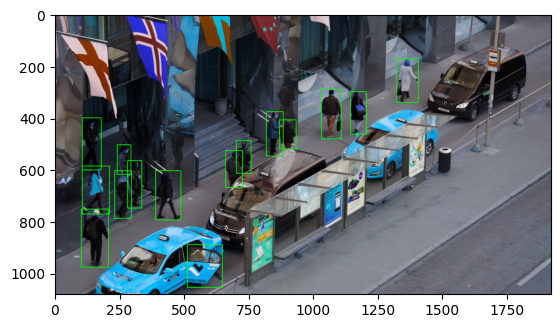

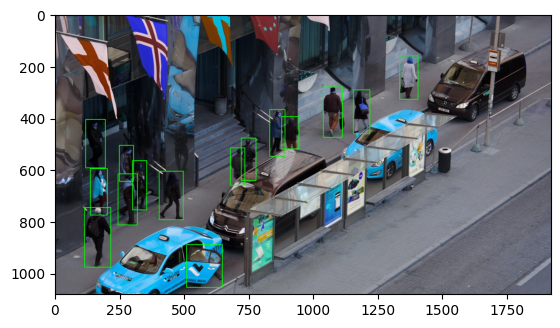

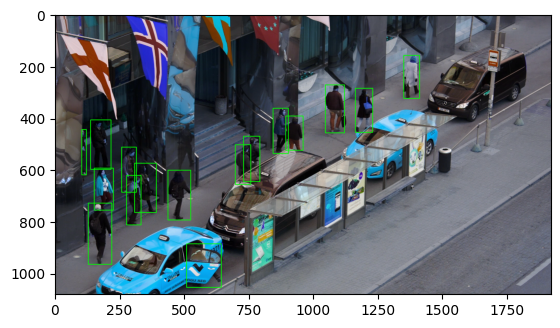

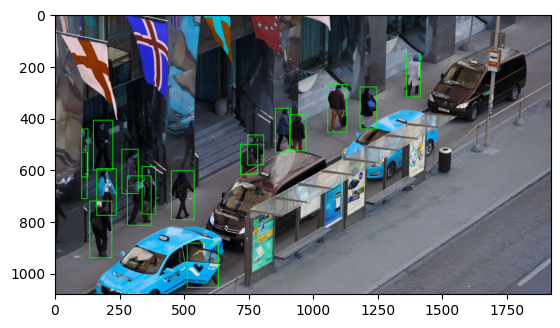

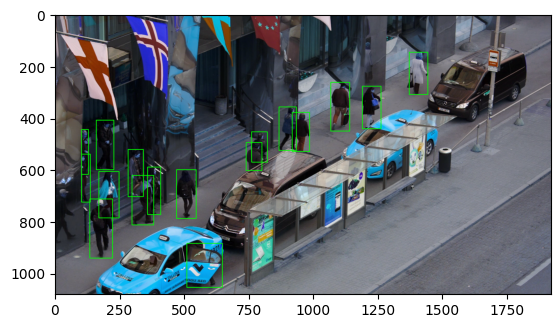

...

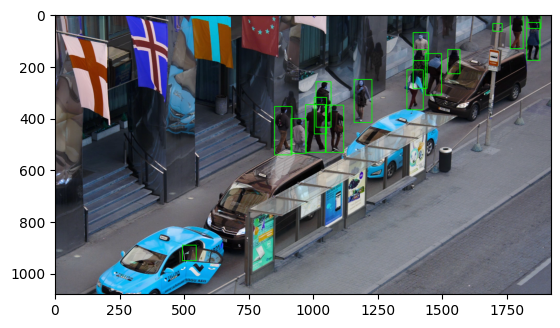

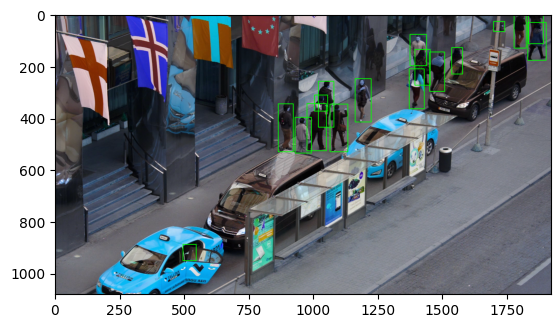

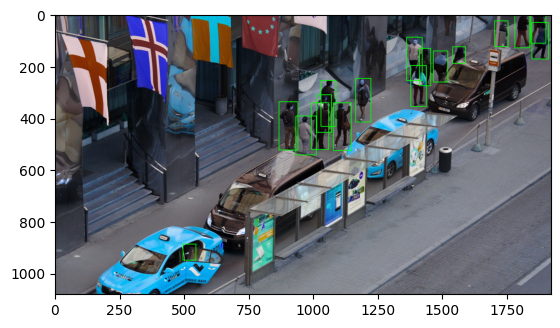

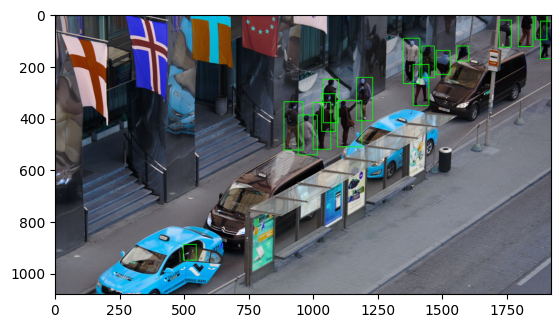

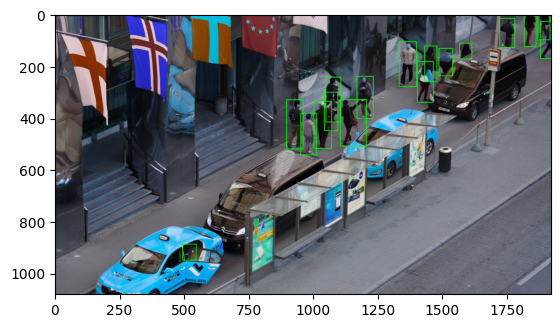

In [4]:
parse_video_for_frames(json_path=Path(r"E:\Python_Projects\HSE_diploma\data\test_from_person\uid_vid_00000.mp4.json"),
                       video_path=Path(r"E:\Python_Projects\HSE_diploma\data\test_from_person\uid_vid_00000.mp4"),
                       save_path=Path("./"))